# Images Analysis

In [1]:
import os
import pandas as pd
import json
import monai
from tqdm.notebook import tqdm
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from glob import glob
from plotly.subplots import make_subplots


 missing cuda symbols while dynamic loading
 cuFile initialization failed


In [2]:
figures_dir = "/home/jaalzate/Prostate_Cancer_TFM/Data_Analysis/Figures/Paper_PNG/Training/"
extension = "png"
colors=(
            "#efc86e",
            "#6f9969",
            "#97c684",
            "#aab5d5",
            "#808fe1",
            "#5c66a8",
            "#454a74",
        )

## Plot Functions

In [7]:
def plot_size_variability_plotly(dimensions, means, std_devs, colors, title, save_as_pdf=False):
    x_pos = [str(dimension) for dimension in dimensions]  # Ensure dimensions are string for Plotly

    # Create traces
    trace = go.Bar(
        x=x_pos,
        y=means,
        error_y=dict(
            type='data',  # or 'percent' for percentage-based errors
            array=std_devs,
            visible=True
        ),
        marker_color=colors  # Set bar colors
    )

    # Create layout
    layout = go.Layout(
        #title='Image Size Variability '+title,
        # xaxis=dict(
        #     title='Dimensions'
        # ),
        yaxis=dict(
            title='Size (pixels)'
        ),
        template='plotly_white',  # Use a white background for the plot
        font=dict(
            size=15,  # Only change the font size
            # color and family are omitted to use defaults
        )

    )

    # Create figure and add traces
    fig = go.Figure(data=[trace], layout=layout)

    # Update layout for a tighter appearance and grid lines
    fig.update_layout(
        autosize=False,
        width=1000,  # Custom width, adjust as needed
        height=600,  # Custom height, adjust as needed
        margin=dict(
            l=20,
            r=20,
            b=40,
            t=20,
            pad=0
        ),
        # plot_bgcolor='rgba(0,0,0,0)',  # Transparent background
        # paper_bgcolor='rgba(0,0,0,0)',  # Transparent paper background
        yaxis=dict(gridcolor='rgba(128,128,128,0.5)'),  # Custom grid color (light grey) and transparency
    )

    
    # Show the figure
    fig.show()
    # Save figure as pdf
    if save_as_pdf:
        fig.write_image(os.path.join(figures_dir,"image_size_variability_plotly_"+title+"."+extension))

In [8]:
def plot_spacing_variability_plotly(dimensions, means, std_devs, colors, title, save_as_pdf=False):
    x_pos = [str(dimension) for dimension in dimensions]  # Ensure dimensions are string for Plotly

    # Create traces
    trace = go.Bar(
        x=x_pos,
        y=means,
        error_y=dict(
            type='data',  # or 'percent' for percentage-based errors
            array=std_devs,
            visible=True
        ),
        marker_color=colors  # Set bar colors
    )

    # Create layout
    layout = go.Layout(
        #title='Image Size Variability '+title,
        # xaxis=dict(
        #     title='Dimensions'
        # ),
        yaxis=dict(
            title='Size (pixels)'
        ),
        template='plotly_white',  # Use a white background for the plot
        font=dict(
            size=15,  # Only change the font size
            # color and family are omitted to use defaults
        )

    )

    # Create figure and add traces
    fig = go.Figure(data=[trace], layout=layout)

    # Update layout for a tighter appearance and grid lines
    fig.update_layout(
        autosize=False,
        width=1000,  # Custom width, adjust as needed
        height=600,  # Custom height, adjust as needed
        margin=dict(
            l=20,
            r=20,
            b=40,
            t=20,
            pad=0
        ),
        # plot_bgcolor='rgba(0,0,0,0)',  # Transparent background
        # paper_bgcolor='rgba(0,0,0,0)',  # Transparent paper background
        yaxis=dict(gridcolor='rgba(128,128,128,0.5)'),  # Custom grid color (light grey) and transparency
    )

    
    # Show the figure
    fig.show()
    # Save figure as pdf
    if save_as_pdf:
        fig.write_image(os.path.join(figures_dir,"image_spacing_variability_plotly_"+title+"."+extension))

In [9]:
def plot_variability_plotly_grouped(means, stds, datasets, colors, title,x_ticks,y_axis_title, save_as_pdf=False):
    width = 0.25  # Equivalent to the bar width in Plotly terms

    # Create a figure
    fig = go.Figure()

    # Add bars for each dataset
    for i, dataset in enumerate(datasets):
        means_dataset = means[dataset]
        stds_dataset = stds[dataset]
        x_positions = [x + i * width for x in range(len(x_ticks))]  # Adjust x positions for grouping
        
        fig.add_trace(go.Bar(
            x=x_positions,
            y=means_dataset,
            error_y=dict(
                type='data',  # Specify that the errors are given explicitly
                array=stds_dataset,
                visible=True
            ),
            name=dataset,
            marker_color=colors[i]  # Set the color for each dataset
        ))

    # Update layout for the figure
    fig.update_layout(
        xaxis=dict(
            tickmode='array',
            tickvals=[x + width for x in range(len(x_ticks))],  # Position x-ticks in the center of groups
            ticktext=x_ticks,  # Label x-ticks with dimension names
            #title='Dimension'
        ),
        yaxis=dict(
            title=y_axis_title
        ),
        # legend=dict(
        #     title='Ori'
        # ),
        barmode='group',  # Group bars instead of stacking
        width=1000,  # Customizable figure size
        height=600,
        template='plotly_white',  # Use a white background for cleaner appearance
        font=dict(size=20),  # Set global font size
        margin=dict(
            l=20,
            r=20,
            b=40,
            t=20,
            pad=0
        )
    )

    # Show the figure
    fig.show()
    if save_as_pdf:
        fig.write_image(os.path.join(figures_dir,"image_variability_plotly_"+title+"."+extension))

In [10]:
def plot_orientation_distribution(orientation_counts):
    orientation_labels = list(orientation_counts.keys())
    orientation_values = list(orientation_counts.values())
    
    # Define colors for the pie chart
    colors = ['lightseagreen', 'gold', 'lightpink', 'lightblue', 'lightgreen', 'violet']

    fig = go.Figure(data=[go.Pie(labels=orientation_labels, values=orientation_values, textinfo='label+percent', insidetextorientation='radial', marker_colors=colors)])
    
    fig.update_layout(
        title_text='Orientation Distribution',
        title_font_size=30,
        #font=dict(size=25, weight='bold'),
        showlegend=True
    )
    
    fig.show()

def plot_separate_orientations(orientation_counts):
    # Assuming orientation_counts is a dictionary like {'Axial': count, 'Coronal': count, 'Sagittal': count}
    subplots_titles = ['Axial', 'Coronal', 'Sagittal']
    colors = ['lightseagreen', 'gold', 'lightpink']  # Colors for each pie chart
    
    fig = go.Figure()

    for i, title in enumerate(subplots_titles):
        fig.add_trace(go.Pie(labels=[title], values=[orientation_counts[title]], name=title, marker_colors=[colors[i]]))
    
    fig.update_traces(textinfo='label+percent', insidetextorientation='radial')
    fig.update_layout(
        title_text='Separate Orientation Distributions',
        title_font_size=30,
        #font=dict(size=25, weight='bold')
    )
    
    # Adjust layout to fit three pie charts
    fig.update_layout(
        grid={'rows': 1, 'columns': 3, 'pattern': 'independent'},
        annotations=[dict(text=text, x=0.5, y=0.5, font_size=20, showarrow=False) for text in subplots_titles]
    )
    
    fig.show()

In [11]:
def plot_pie_simple(label, count, title = "Pie Chart", size = (400, 400), out_filename = None):
    # Create traces
    trace = go.Pie(labels=label, values=count, textinfo='label+percent', textposition="outside", marker=dict(colors=colors))
    # Create layout
    w, h = size
    layout = go.Layout(
        width=w,
        height=h,
        title=title,
        plot_bgcolor='rgba(0,0,0,0)',
        paper_bgcolor='rgba(0,0,0,0)',
        showlegend=False
    )
    # Create figure and add traces
    fig = go.Figure(data=trace, layout=layout)
    # Show figure
    fig.show()
    # Save figure
    if out_filename:
        fig.write_image(os.path.join(figures_dir,f"{out_filename}.{extension}"))

In [12]:
def plot_bar_simple(label, count, title = "Bar Chart", x_axis = "Variable", variable_names = [], size = (800, 400), out_filename = None):
    # Create traces
    trace = go.Bar(x=label, y=count, text=count, marker_color=colors)
    
    # Create layout
    layout = go.Layout(
        title=title,
        xaxis_title=x_axis,
        yaxis_title='Frequency',
        plot_bgcolor='rgba(0,0,0,0)',
    )
    
    # Create figure and add traces
    fig = go.Figure(data=trace, layout=layout)

    if not variable_names:
        variable_names = label
    fig.update_layout(
        xaxis=dict(
            tickmode='array',
            tickvals=[x for x in label],
            ticktext=[(v if str(v) != "nan" else "N/A") for v in variable_names],  # Label x-ticks with dimension names
            #title='Dimension'
        ),
        template='plotly_white',
    )
    
    # Show figure
    fig.show()
    # Save figure
    if out_filename:
        fig.write_image(os.path.join(figures_dir,f"{out_filename}.{extension}"))

In [13]:
def plot_box_simple(label, values, name = "", title = "Box Plot", x_axis = "", size = (800, 400), out_filename = None):
    # Create traces
    trace = go.Box(x=values, name=label, marker_color=colors[0], boxmean='sd', orientation="h")
    
    # Create figure and add traces
    fig = go.Figure(data=trace)

    w, h = size
    if not name:
        name = label
    fig.update_layout(
        title_text=title,
        template='plotly_white',
        height=h,
        width=w,
        xaxis_title=x_axis,
        yaxis=dict(tickmode='array',
            tickvals=[0],
            ticktext=[name],
        )
    )
    
    # Show figure
    fig.show()
    # Save figure
    if out_filename:
        fig.write_image(os.path.join(figures_dir,f"{out_filename}.{extension}"))

In [14]:
def get_seg_prostate_volume(subject, session):
    transforms = monai.transforms.Compose([monai.transforms.LoadImaged(keys=["seg"],allow_missing_keys=True,image_only=False)])
    
    base_path = f"/mnt/ceib/datalake/FISABIO_datalake/p0042021/derivatives/prostate_segmentation/sub-{subject:06d}/ses-{session:06d}/mim-mr/anat/sub-{subject:06d}_ses-{session:06d}_*-ax_mod-T2w_desc-SEG.nii.gz"
    data = [{"seg": filepath} for filepath in [path for path in glob(base_path)]]
    if not data:
        return None
    volume = []
    for segmentation in data:
        transformed_data = transforms(segmentation)
        seg = transformed_data['seg']
        res = np.prod(list(transformed_data['seg_meta_dict']['pixdim'][1:4])) / (10**3) # cm3
        volume.append(res * np.sum(seg))
    return np.mean(volume)

In [14]:
import os
# Creating  tables
path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021"
derivatives_path = "/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021/derivatives/creating_adc"
t2_list = []
adc_list = []
dwi_list = []

# Creating a list of all the files in the directory starting with sub-*
subjects = [f for f in os.listdir(path) if f.startswith("sub-")]
derivatives_subs = [f for f in os.listdir(derivatives_path) if f.startswith("sub-")]

for sub in subjects:
    derivative_sessions=None
    if sub in derivatives_subs:
        derivative_sessions = [f for f in os.listdir(os.path.join(derivatives_path, sub)) if f.startswith("ses-")]
    sessions = [f for f in os.listdir(os.path.join(path, sub)) if f.startswith("ses-")]
    for ses in sessions:
        # Check if the anat and dwi paths exist
        anat_path = os.path.join(path, sub, ses,'mim-mr','anat')
        dwi_path = os.path.join(path, sub, ses,'mim-mr','dwi')

        if os.path.exists(anat_path):
            images_anat = [f for f in os.listdir(anat_path) if f.endswith(".nii.gz")]
            for img in images_anat:
                if 'T2w' in img and 'chunk' not in img:
                    json_path = os.path.join(path, sub, ses,'mim-mr','anat', img.replace('.nii.gz', '.json'))
                    with open(json_path) as f:
                        data = json.load(f)
                    #Add json data to the dict image
                    img_dict = {'subject': sub, 'session': ses, 'image': img, 'modality': 'T2w'}
                    img_dict.update(data)
                    t2_list.append(img_dict)
        if os.path.exists(dwi_path):
            images_dwi = [f for f in os.listdir(dwi_path) if f.endswith(".nii.gz")]
            for img in images_dwi:
                if 'bvalue' in img and 'chunk' not in img:
                    json_path = os.path.join(path, sub, ses,'mim-mr','dwi', img.replace('.nii.gz', '.json'))
                    with open(json_path) as f:
                        data = json.load(f)
                    #Add json data to the dict image
                    img_dict = {'subject': sub, 'session': ses, 'image': img, 'modality': 'dwi'}
                    img_dict.update(data)
                    dwi_list.append(img_dict)
                elif 'adc' in img and 'chunk' not in img:
                    json_path = os.path.join(path, sub, ses,'mim-mr','dwi', img.replace('.nii.gz', '.json'))
                    with open(json_path) as f:
                        data = json.load(f)
                    #Add json data to the dict image
                    img_dict = {'subject': sub, 'session': ses, 'image': img, 'modality': 'adc'}
                    img_dict.update(data)
                    adc_list.append(img_dict)
    # if derivative_sessions:
    #     for ses in derivative_sessions:
    #         der_dwi_path = os.path.join(derivatives_path, sub, ses,'mim-mr','dwi')
    #         images_dwi = [f for f in os.listdir(der_dwi_path) if f.endswith(".nii.gz")]
    #         for img in images_dwi:
    #             json_path = os.path.join(derivatives_path, sub, ses,'mim-mr','dwi', img.replace('.nii.gz', '.json'))
    #             with open(json_path) as f:
    #                 data = json.load(f)
    #             #Add json data to the dict image
    #             img_dict = {'subject': sub, 'session': ses, 'image': img, 'modality': 'derivatives-adc'}
    #             img_dict.update(data)
    #             adc_list.append(img_dict)


t2w_df = pd.DataFrame(t2_list)
dwi_df = pd.DataFrame(dwi_list)
adc_df = pd.DataFrame(adc_list)


In [31]:
print(t2w_df.columns.values)

['subject' 'session' 'image' 'modality' 'AccessionNumber'
 'AcquisitionDate' 'AcquisitionDuration' 'AcquisitionMatrix'
 'AcquisitionNumber' 'AcquisitionTime' 'B1rms' 'BitsAllocated'
 'BitsStored' 'BodyPartExamined' 'Columns' 'ContentDate' 'ContentTime'
 'DeidentificationMethod' 'DeidentificationMethodCodeSequence'
 'DiffusionBValue' 'DiffusionGradientOrientation'
 'DigitalImageFormatAcquired' 'EchoNumbers' 'EchoTime' 'EchoTrainLength'
 'EthnicGroup' 'FlipAngle' 'FrameOfReferenceUID' 'HeartRate' 'HighBit'
 'HighRRValue' 'ImageOrientationPatient' 'ImagePositionPatient'
 'ImageType' 'ImagedNucleus' 'ImagingFrequency'
 'InPlanePhaseEncodingDirection' 'InstanceNumber' 'IntervalsAcquired'
 'IntervalsRejected' 'Laterality'
 'LongitudinalTemporalInformationModified' 'LowRRValue'
 'MRAcquisitionType' 'MagneticFieldStrength' 'Manufacturer'
 'ManufacturerModelName' 'Modality' 'NumberOfAverages'
 'NumberOfPhaseEncodingSteps' 'NumberOfTemporalPositions' 'PatientAge'
 'PatientBirthDate' 'PatientComm

## DICOM Metadata

### T2w

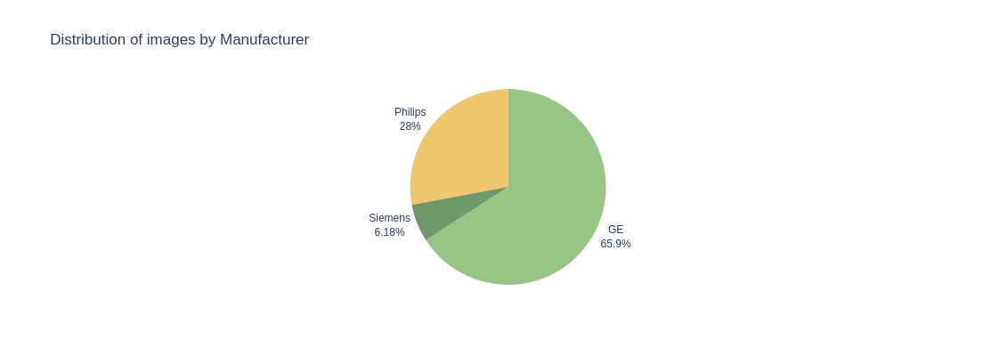

In [77]:
manufacturer_counts = t2w_df["Manufacturer"].value_counts(normalize=True, dropna=True).to_dict()
manufacturer_counts = {key: manufacturer_counts[key] for key in sorted(manufacturer_counts)}
manufacturer_counts["GE"] = manufacturer_counts.pop("GE MEDICAL SYSTEMS")
manufacturer_counts["Philips"] += manufacturer_counts.pop("Philips Medical Systems")
manufacturer_counts["Siemens"] += manufacturer_counts.pop("SIEMENS") + manufacturer_counts.pop("Siemens HealthCare GmbH")
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_pie_simple(label, 
                count, 
                title="Distribution of images by Manufacturer",
                size=(500,400),
                out_filename="images_by_manufacturer")

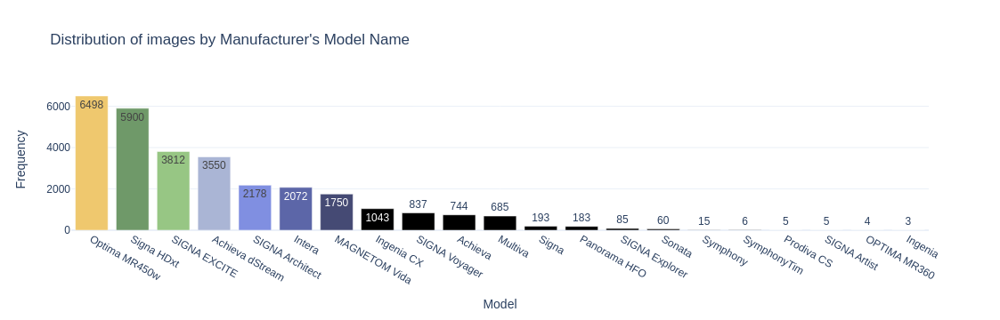

In [78]:
manufacturer_counts = t2w_df["ManufacturerModelName"].value_counts(normalize=False, dropna=True).to_dict()
manufacturer_counts["SIGNA Voyager"] += manufacturer_counts.pop("Signa Voyager")
manufacturer_counts = {key: manufacturer_counts[key] for key in sorted(manufacturer_counts, key=lambda x: manufacturer_counts.get(x), reverse=True)}
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_bar_simple(label, count, 
                title="Distribution of images by Manufacturer's Model Name",
                size=(500, 400),
                x_axis = "Model",
                out_filename="images_by_manufacturermodelname")

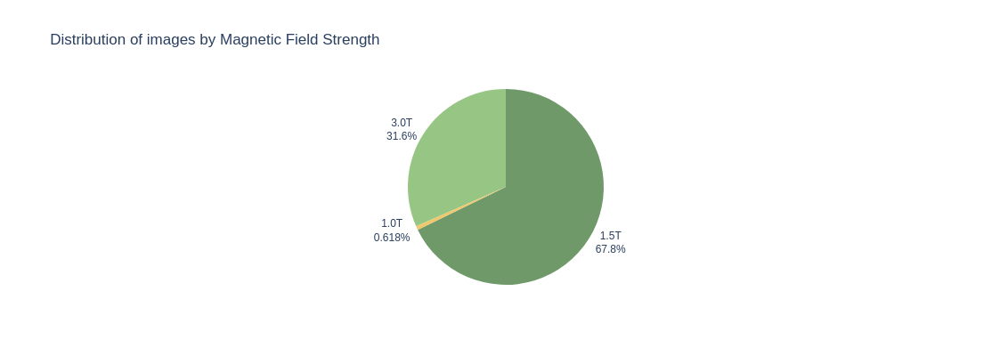

In [79]:
manufacturer_counts = t2w_df["MagneticFieldStrength"].value_counts(normalize=True, dropna=True).to_dict()
manufacturer_counts = {f"{key}T": manufacturer_counts[key] for key in sorted(manufacturer_counts)}
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_pie_simple(label, count, 
                title="Distribution of images by Magnetic Field Strength", 
                size=(500, 400),
                out_filename="images_by_fieldstrength")

### DWI

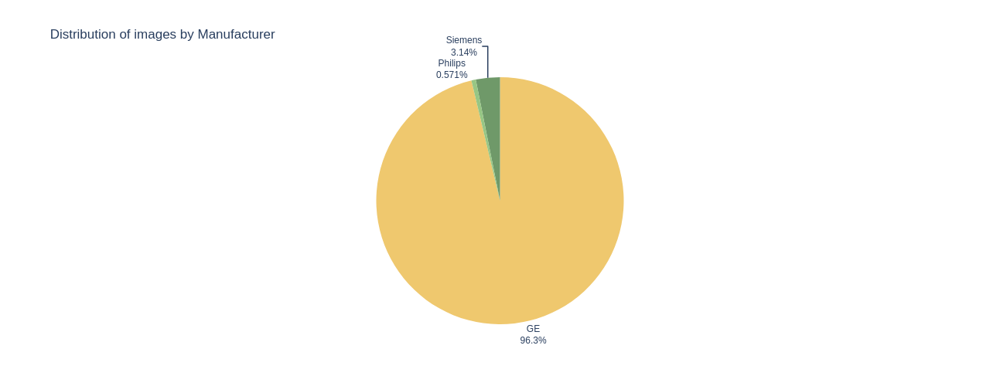

In [437]:
manufacturer_counts = dwi_df["Manufacturer"].value_counts(normalize=True, dropna=True).to_dict()
manufacturer_counts = {key: manufacturer_counts[key] for key in sorted(manufacturer_counts)}
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_pie_simple(label, count, title="Distribution of images by Manufacturer",  size=(400, 500), out_filename="images_by_manufacturer")

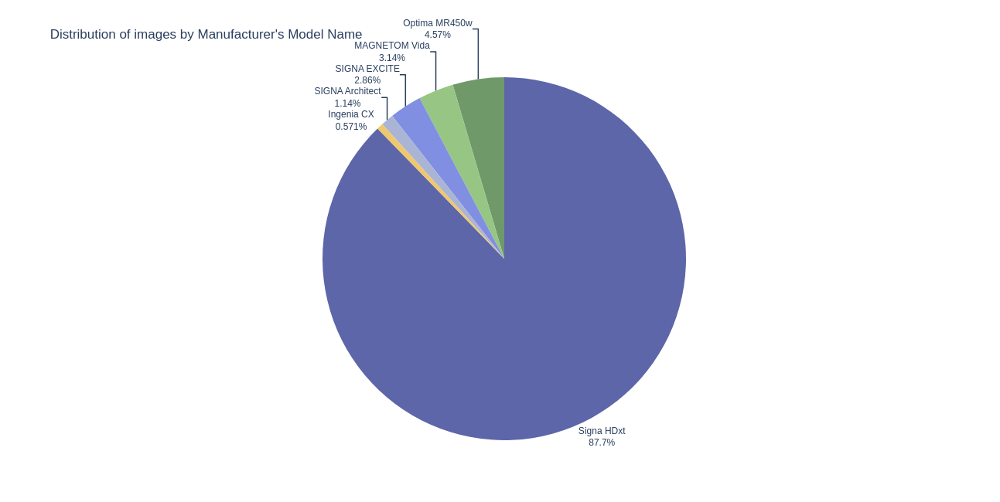

In [443]:
manufacturer_counts = dwi_df["ManufacturersModelName"].value_counts(normalize=True, dropna=True).to_dict()
manufacturer_counts = {key: manufacturer_counts[key] for key in sorted(manufacturer_counts)}
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_pie_simple(label, count, 
                title="Distribution of images by Manufacturer's Model Name",
                size=(500, 650),
                out_filename="images_by_manufacturersmodelname")

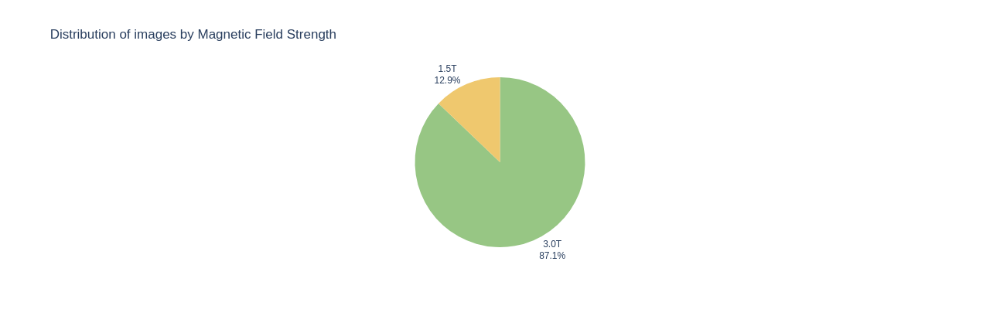

In [444]:
manufacturer_counts = dwi_df["MagneticFieldStrength"].value_counts(normalize=True, dropna=True).to_dict()
manufacturer_counts = {f"{key}T": manufacturer_counts[key] for key in sorted(manufacturer_counts)}
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_pie_simple(label, count, 
                title="Distribution of images by Magnetic Field Strength", 
                size=(500, 400),
                out_filename="images_by_fieldstrength")

### ADC

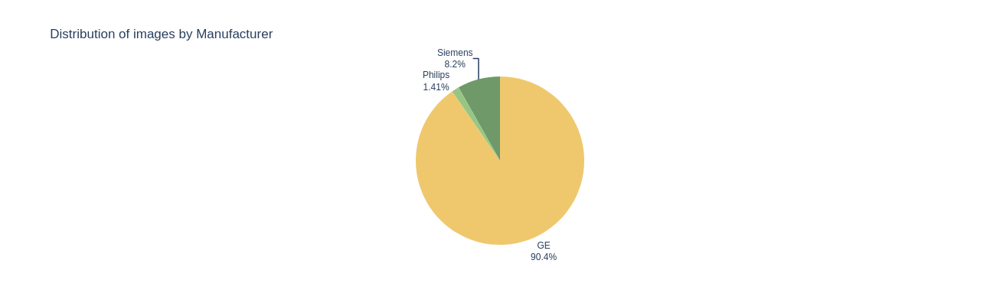

In [476]:
manufacturer_counts = adc_df["Manufacturer"].value_counts(normalize=True, dropna=True).to_dict()
manufacturer_counts = {key: manufacturer_counts[key] for key in sorted(manufacturer_counts)}
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_pie_simple(label, count, title="Distribution of images by Manufacturer",  size=(400, 400), out_filename="images_by_manufacturer")

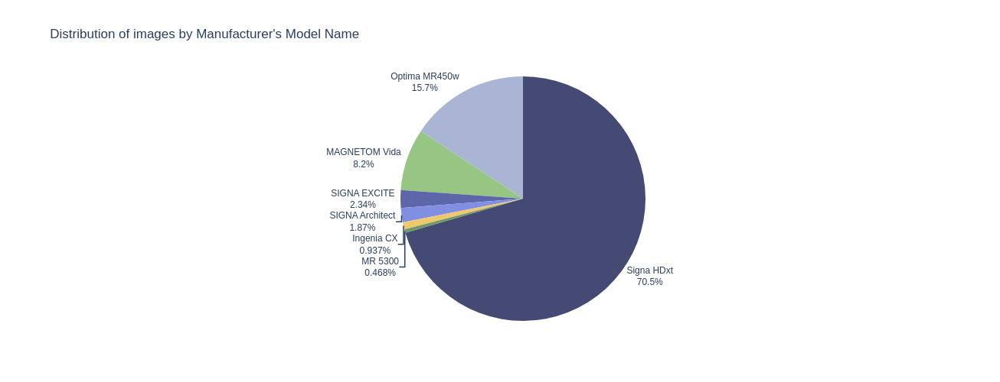

In [478]:
manufacturer_counts = adc_df["ManufacturersModelName"].value_counts(normalize=True, dropna=True).to_dict()
manufacturer_counts = {key: manufacturer_counts[key] for key in sorted(manufacturer_counts)}
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_pie_simple(label, count, 
                title="Distribution of images by Manufacturer's Model Name",
                size=(500, 500),
                out_filename="images_by_manufacturersmodelname")

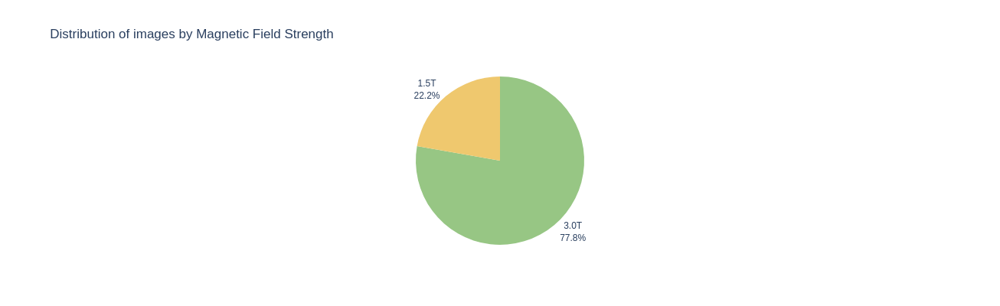

In [479]:
manufacturer_counts = adc_df["MagneticFieldStrength"].value_counts(normalize=True, dropna=True).to_dict()
manufacturer_counts = {f"{key}T": manufacturer_counts[key] for key in sorted(manufacturer_counts)}
label, count = list(manufacturer_counts.keys()), list(manufacturer_counts.values())
plot_pie_simple(label, count, 
                title="Distribution of images by Magnetic Field Strength", 
                size=(500, 400),
                out_filename="images_by_fieldstrength")

## Image Size Variability

### T2w

In [54]:
images_paths = t2w_df.copy().apply(lambda x: os.path.join(path, x['subject'], x['session'],'mim-mr','anat', x['image']), axis=1)

# Divide into axial, coronal and sagital images
data_list = []
for path in images_paths.values:
    files = {}
    image_name = path.split('/')[-1]
    if 'sag' in image_name:
        files['sagital'] = path
    elif 'cor' in image_name:
        files['coronal'] = path
    elif 'ax' in image_name:
        files['axial'] = path
    data_list.append(files)

transforms = monai.transforms.Compose(
            [
                monai.transforms.LoadImaged(keys=["sagital", "coronal", "axial"],allow_missing_keys=True,image_only=False),
                ]
)

train_ds = monai.data.Dataset(
    data=data_list,
    transform=transforms,
)

In [66]:
axial.shape

torch.Size([640, 640, 25])

In [68]:
data_list

[{'axial': '/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021/sub-003629/ses-003863/mim-mr/anat/sub-003629_ses-003863_acq-fse_run-501_bp-breast_vp-ax_T2w.nii.gz'},
 {'axial': '/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021/sub-003629/ses-003863/mim-mr/anat/sub-003629_ses-003863_acq-fse_run-301_bp-breast_vp-ax_T2w.nii.gz'},
 {'axial': '/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021/sub-003629/ses-003863/mim-mr/anat/sub-003629_ses-003863_acq-fse_run-601_bp-breast_vp-ax_T2w.nii.gz'},
 {'axial': '/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021/sub-005730/ses-006206/mim-mr/anat/sub-005730_ses-006206_acq-fse_run-4_bp-pelvis_vp-ax_T2w.nii.gz'},
 {'axial': '/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021/sub-005730/ses-006206/mim-mr/anat/sub-005730_ses-006206_acq-fse_run-9_bp-pelvis_vp-ax_T2w.nii.gz'},
 {'axial': '/mnt/ceib/datalake/FISABIO_datalake/prueba/p0052021/sub-005730/ses-006206/mim-mr/anat/sub-005730_ses-006206_acq-fse_run-6_bp-pelvis_vp-ax_T2w.nii.gz'},
 {'axial':

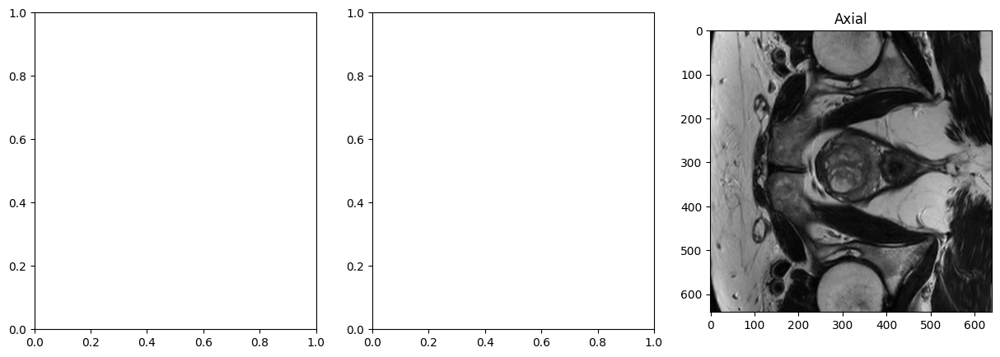

In [67]:
#plot sample images
# sagital = train_ds[0]['sagital']
# coronal = train_ds[5]['coronal']
axial = train_ds[2]['axial']

fig, axs = plt.subplots(1, 3, figsize=(15, 5))
# axs[0].imshow(sagital[:, :,12], cmap='gray')
# axs[0].set_title('Sagital')

# axs[1].imshow(coronal[ :, :,12], cmap='gray')
# axs[1].set_title('Coronal')

plt.imshow(axial[ :, :,12], cmap='gray')
plt.title('Axial')

plt.show()

In [237]:
image_sizes_axial = []
image_sizes_coronal = []
image_sizes_sagital = []
for image in tqdm(train_ds):
    if 'sagital' in image.keys():
        image_sizes_sagital.append(list(image['sagital'].shape))
    if 'coronal' in image.keys():
        image_sizes_coronal.append(list(image['coronal'].shape))
    if 'axial' in image.keys():
        image_sizes_axial.append(list(image['axial'].shape))


  0%|          | 0/493 [00:00<?, ?it/s]

In [239]:
widths_axial = [size[0] for size in image_sizes_axial]
heights_axial = [size[1] for size in image_sizes_axial]
depths_axial = [size[2] for size in image_sizes_axial]

widths_coronal = [size[0] for size in image_sizes_coronal]
heights_coronal = [size[1] for size in image_sizes_coronal]
depths_coronal = [size[2] for size in image_sizes_coronal]

widths_sagital = [size[0] for size in image_sizes_sagital]
heights_sagital = [size[1] for size in image_sizes_sagital]
depths_sagital = [size[2] for size in image_sizes_sagital]


In [240]:
mean_width_axial = np.mean(widths_axial)
std_width_axial = np.std(widths_axial)
mean_height_axial = np.mean(heights_axial)
std_height_axial = np.std(heights_axial)
mean_depth_axial = np.mean(depths_axial)
std_depth_axial = np.std(depths_axial)

mean_width_coronal = np.mean(widths_coronal)
std_width_coronal = np.std(widths_coronal)
mean_height_coronal = np.mean(heights_coronal)
std_height_coronal = np.std(heights_coronal)
mean_depth_coronal = np.mean(depths_coronal)
std_depth_coronal = np.std(depths_coronal)

mean_width_sagital = np.mean(widths_sagital)
std_width_sagital = np.std(widths_sagital)
mean_height_sagital = np.mean(heights_sagital)
std_height_sagital = np.std(heights_sagital)
mean_depth_sagital = np.mean(depths_sagital)
std_depth_sagital = np.std(depths_sagital)


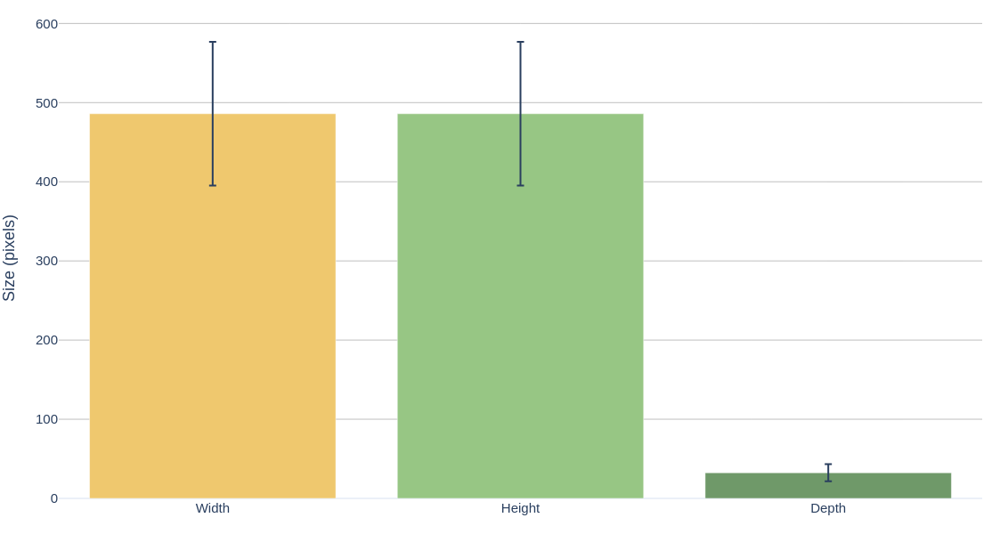

In [241]:
plot_size_variability_plotly(['Width', 'Height', 'Depth'],
                            [mean_width_axial, mean_height_axial, mean_depth_axial],
                            [std_width_axial, std_height_axial, std_depth_axial], 
                            colors,
                            'T2w Axial',
                            save_as_pdf=True)

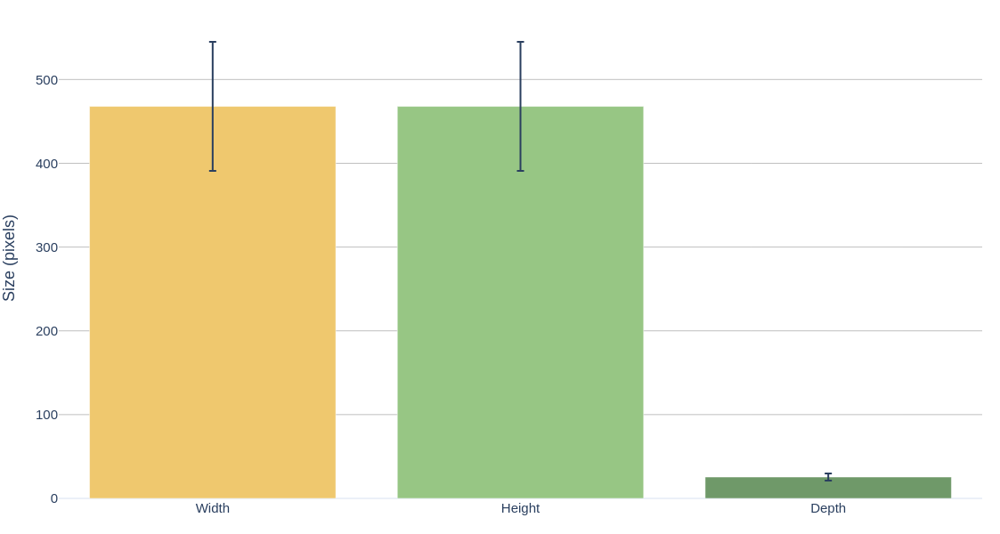

In [242]:
plot_size_variability_plotly(['Width', 'Height', 'Depth'],
                    [mean_width_coronal, mean_height_coronal, mean_depth_coronal],
                    [std_width_coronal, std_height_coronal, std_depth_coronal], 
                    colors,
                    'T2w Coronal',
                    save_as_pdf=True)

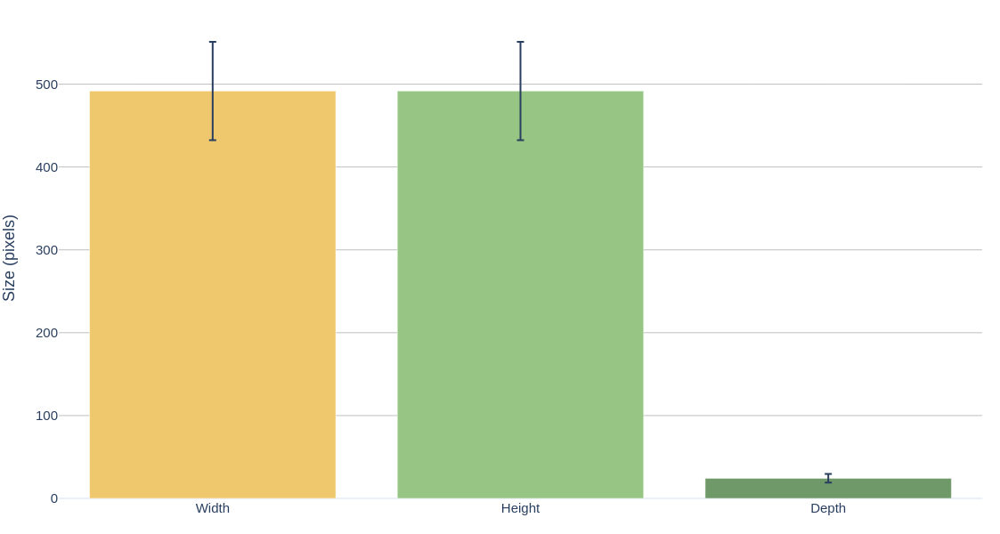

In [243]:
plot_size_variability_plotly(['Width', 'Height', 'Depth'],
                    [mean_width_sagital, mean_height_sagital, mean_depth_sagital],
                    [std_width_sagital, std_height_sagital, std_depth_sagital], 
                    colors,
                    'T2w Sagital',
                    save_as_pdf=True)

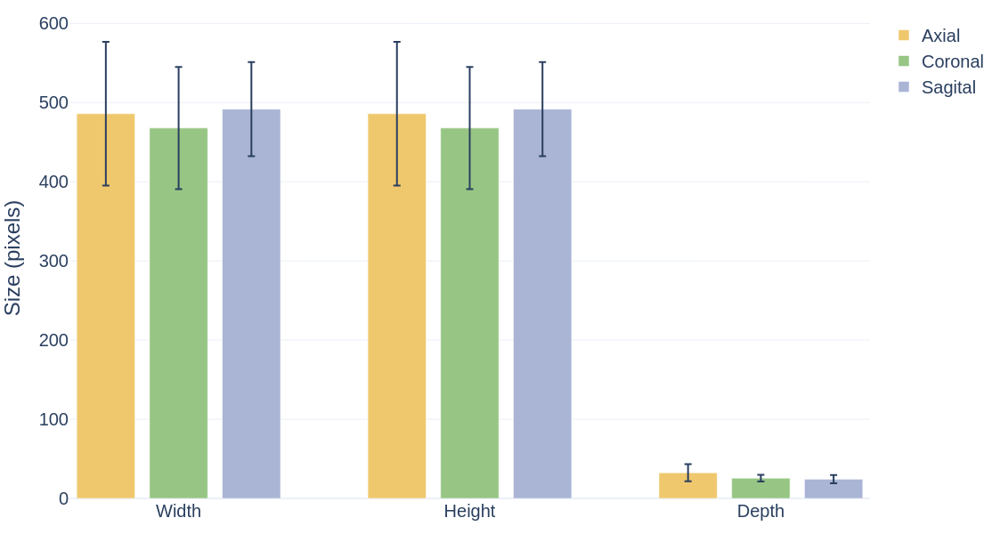

In [244]:
x_ticks = ['Width', 'Height', 'Depth']  # Base positions for each group of bars
y_axis_title = 'Size (pixels)'
#random order of colors
colors_sub = np.random.choice(colors, 3, replace=False)
plot_variability_plotly_grouped( {'Axial': [mean_width_axial, mean_height_axial, mean_depth_axial],
                                      'Coronal': [mean_width_coronal, mean_height_coronal, mean_depth_coronal],
                                      'Sagital': [mean_width_sagital, mean_height_sagital, mean_depth_sagital]},
                                    {'Axial': [std_width_axial, std_height_axial, std_depth_axial],
                                      'Coronal': [std_width_coronal, std_height_coronal, std_depth_coronal],
                                      'Sagital': [std_width_sagital, std_height_sagital, std_depth_sagital]},
                                    ['Axial', 'Coronal', 'Sagital'],
                                    colors_sub,
                                    'size_T2w_grouped',
                                    x_ticks,
                                    y_axis_title,
                                    save_as_pdf=True)

### DWI

In [454]:
images_paths = dwi_df.copy().apply(lambda x: os.path.join(path, x['subject'], x['session'],'mim-mr','dwi', x['image']), axis=1)

# Divide into axial, coronal and sagital images
data_list = []
for path in images_paths.values:
    files = {}
    image_name = path.split('/')[-1]
    if 'sag' in image_name:
        files['sagital'] = path
    elif 'cor' in image_name:
        files['coronal'] = path
    elif 'ax' in image_name:
        files['axial'] = path
    data_list.append(files)

transforms = monai.transforms.Compose(
            [
                monai.transforms.LoadImaged(keys=["sagital", "coronal", "axial"],allow_missing_keys=True,image_only=False),
                ]
)

train_ds = monai.data.Dataset(
    data=data_list,
    transform=transforms,
)

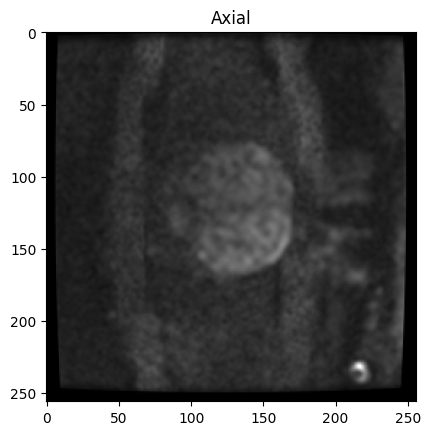

In [457]:
#plot sample images
axial = train_ds[1]['axial']

plt.imshow(axial[ :, :,12, 0], cmap='gray')
plt.title('Axial')

plt.show()

In [458]:
image_sizes_axial = []
for image in tqdm(train_ds):
    if 'axial' in image.keys():
        image_sizes_axial.append(list(image['axial'].shape))


  0%|          | 0/350 [00:00<?, ?it/s]

In [459]:
widths_axial = [size[0] for size in image_sizes_axial]
heights_axial = [size[1] for size in image_sizes_axial]
depths_axial = [size[2] for size in image_sizes_axial]


In [460]:
mean_width_axial = np.mean(widths_axial)
std_width_axial = np.std(widths_axial)
mean_height_axial = np.mean(heights_axial)
std_height_axial = np.std(heights_axial)
mean_depth_axial = np.mean(depths_axial)
std_depth_axial = np.std(depths_axial)


/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:206: RuntimeWarning:

Degrees of freedom <= 0 for slice

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:163: RuntimeWarning:

invalid value encountered in divide

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:198: RuntimeWarning:

invalid value encountered in scalar divide



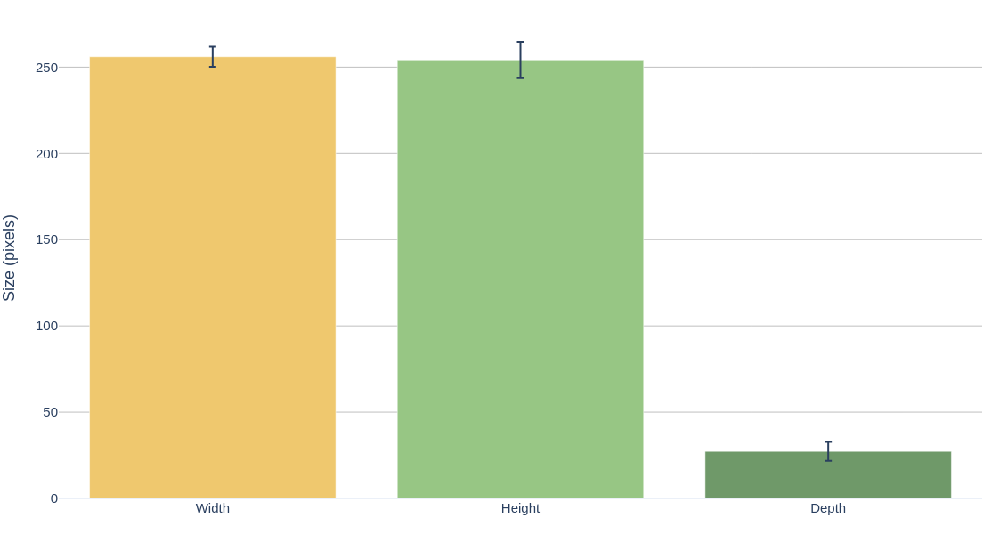

In [461]:
plot_size_variability_plotly(['Width', 'Height', 'Depth'],
                            [mean_width_axial, mean_height_axial, mean_depth_axial],
                            [std_width_axial, std_height_axial, std_depth_axial], 
                            colors,
                            'DWI Axial',
                            save_as_pdf=True)

### ADC

In [512]:


images_paths = adc_df.copy().apply(lambda x: os.path.join(path, x['subject'], x['session'],'mim-mr','dwi', x['image']) if x["modality"] == "adc" else os.path.join(path, "derivatives", "creating_adc", x['subject'], x['session'],'mim-mr','dwi', x['image']), axis=1)

# Divide into axial, coronal and sagital images
data_list = []
for path_ in images_paths.values:
    files = {}
    image_name = path_.split('/')[-1]
    if 'sag' in image_name:
        files['sagital'] = path_
    elif 'cor' in image_name:
        files['coronal'] = path_
    elif 'ax' in image_name:
        files['axial'] = path_
    data_list.append(files)

transforms = monai.transforms.Compose(
            [
                monai.transforms.LoadImaged(keys=["sagital", "coronal", "axial"],allow_missing_keys=True,image_only=False),
                ]
)

train_ds = monai.data.Dataset(
    data=data_list,
    transform=transforms,
)

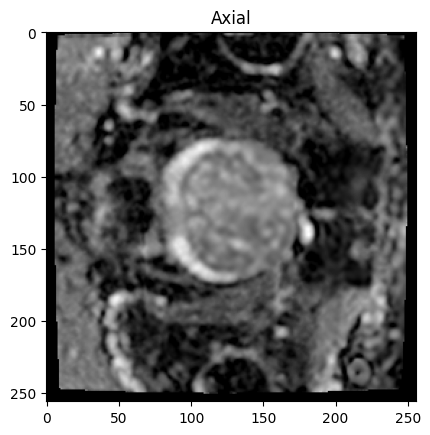

In [513]:
#plot sample images
axial = train_ds[1]['axial']

plt.imshow(axial[ :, :, 12], cmap='gray')
plt.title('Axial')

plt.show()

In [515]:
image_sizes_axial = []
for image in tqdm(train_ds):
    if 'axial' in image.keys():
        image_sizes_axial.append(list(image['axial'].shape))


  0%|          | 0/427 [00:00<?, ?it/s]

In [516]:
widths_axial = [size[0] for size in image_sizes_axial]
heights_axial = [size[1] for size in image_sizes_axial]
depths_axial = [size[2] for size in image_sizes_axial]


In [517]:
mean_width_axial = np.mean(widths_axial)
std_width_axial = np.std(widths_axial)
mean_height_axial = np.mean(heights_axial)
std_height_axial = np.std(heights_axial)
mean_depth_axial = np.mean(depths_axial)
std_depth_axial = np.std(depths_axial)


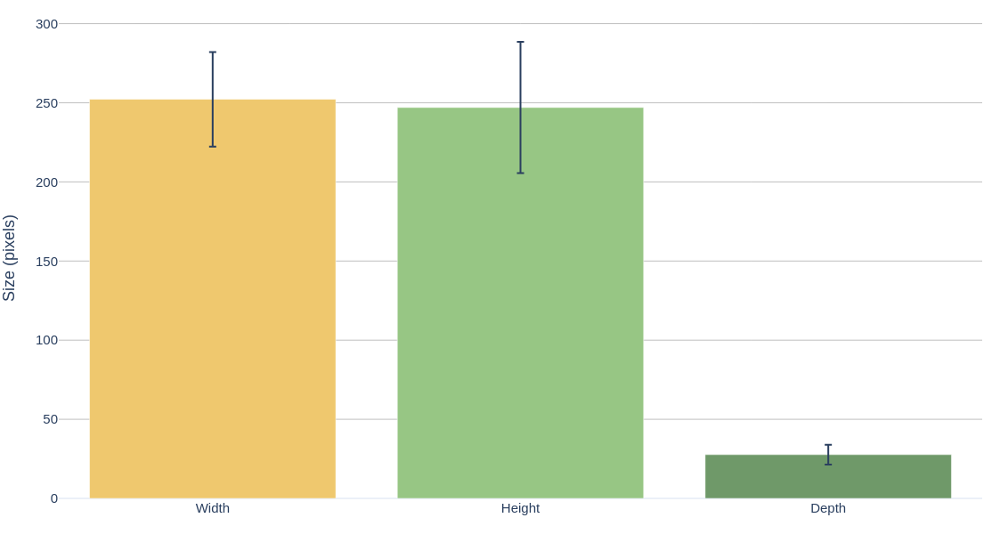

In [524]:
plot_size_variability_plotly(['Width', 'Height', 'Depth'],
                            [mean_width_axial, mean_height_axial, mean_depth_axial],
                            [std_width_axial, std_height_axial, std_depth_axial], 
                            colors,
                            'ADC Axial',
                            save_as_pdf=True)

## In Plane Resolution

### T2w

In [245]:
image_spacings_axial = []
image_spacings_coronal = []
image_spacings_sagital = []

for image in tqdm(train_ds):
    if 'sagital' in image.keys():
        image_spacings_sagital.append(list(image['sagital_meta_dict']['pixdim'][1:4]))
    if 'coronal' in image.keys():
        image_spacings_coronal.append(list(image['coronal_meta_dict']['pixdim'][1:4]))
    if 'axial' in image.keys():
        image_spacings_axial.append(list(image['axial_meta_dict']['pixdim'][1:4]))

  0%|          | 0/493 [00:00<?, ?it/s]

In [246]:
xs_axial = [dim[0] for dim in image_spacings_axial]
ys_axial = [dim[1] for dim in image_spacings_axial]
zs_axial = [dim[2] for dim in image_spacings_axial]

xs_coronal = [dim[0] for dim in image_spacings_coronal]
ys_coronal = [dim[1] for dim in image_spacings_coronal]
zs_coronal = [dim[2] for dim in image_spacings_coronal]

xs_sagital = [dim[0] for dim in image_spacings_sagital]
ys_sagital = [dim[1] for dim in image_spacings_sagital]
zs_sagital = [dim[2] for dim in image_spacings_sagital]

In [247]:
mean_x_axial = np.mean(xs_axial)
std_x_axial = np.std(xs_axial)
mean_y_axial = np.mean(ys_axial)
std_y_axial = np.std(ys_axial)
mean_z_axial = np.mean(zs_axial)
std_z_axial = np.std(zs_axial)

mean_x_coronal = np.mean(xs_coronal)
std_x_coronal = np.std(xs_coronal)
mean_y_coronal = np.mean(ys_coronal)
std_y_coronal = np.std(ys_coronal)
mean_z_coronal = np.mean(zs_coronal)
std_z_coronal = np.std(zs_coronal)

mean_x_sagital = np.mean(xs_sagital)
std_x_sagital = np.std(xs_sagital)
mean_y_sagital = np.mean(ys_sagital)
std_y_sagital = np.std(ys_sagital)
mean_z_sagital = np.mean(zs_sagital)
std_z_sagital = np.std(zs_sagital)

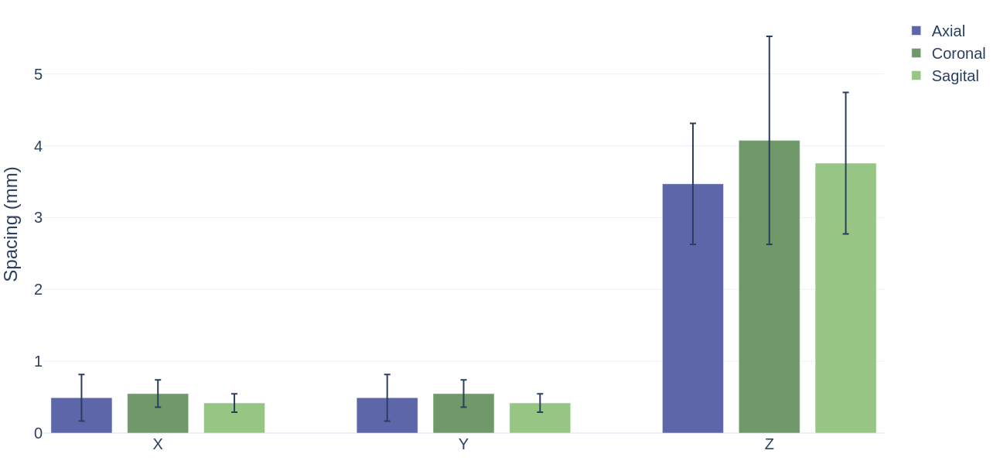

In [248]:
import random
x_ticks = ['X', 'Y', 'Z']  # Base positions for each group of bars
y_axis_title = 'Spacing (mm)'
colors_sub = np.random.choice(colors, 3, replace=False)
plot_variability_plotly_grouped( {'Axial': [mean_x_axial, mean_y_axial, mean_z_axial],
                                'Coronal': [mean_x_coronal, mean_y_coronal, mean_z_coronal],
                                'Sagital': [mean_x_sagital, mean_y_sagital, mean_z_sagital]},
                                {'Axial': [std_x_axial, std_y_axial, std_z_axial],
                                'Coronal': [std_x_coronal, std_y_coronal, std_z_coronal],
                                'Sagital': [std_x_sagital, std_y_sagital, std_z_sagital]},
                                ['Axial', 'Coronal', 'Sagital'],
                                colors_sub,
                                'spacing_T2w_grouped',
                                x_ticks,
                                y_axis_title,
                                save_as_pdf=True)

### DWI

In [464]:
image_spacings_axial = []
image_spacings_coronal = []
image_spacings_sagital = []

for image in tqdm(train_ds):
    if 'sagital' in image.keys():
        image_spacings_sagital.append(list(image['sagital_meta_dict']['pixdim'][1:4]))
    if 'coronal' in image.keys():
        image_spacings_coronal.append(list(image['coronal_meta_dict']['pixdim'][1:4]))
    if 'axial' in image.keys():
        image_spacings_axial.append(list(image['axial_meta_dict']['pixdim'][1:4]))

  0%|          | 0/350 [00:00<?, ?it/s]

In [465]:
xs_axial = [dim[0] for dim in image_spacings_axial]
ys_axial = [dim[1] for dim in image_spacings_axial]
zs_axial = [dim[2] for dim in image_spacings_axial]

xs_coronal = [dim[0] for dim in image_spacings_coronal]
ys_coronal = [dim[1] for dim in image_spacings_coronal]
zs_coronal = [dim[2] for dim in image_spacings_coronal]

xs_sagital = [dim[0] for dim in image_spacings_sagital]
ys_sagital = [dim[1] for dim in image_spacings_sagital]
zs_sagital = [dim[2] for dim in image_spacings_sagital]

In [466]:
mean_x_axial = np.mean(xs_axial)
std_x_axial = np.std(xs_axial)
mean_y_axial = np.mean(ys_axial)
std_y_axial = np.std(ys_axial)
mean_z_axial = np.mean(zs_axial)
std_z_axial = np.std(zs_axial)

mean_x_coronal = np.mean(xs_coronal)
std_x_coronal = np.std(xs_coronal)
mean_y_coronal = np.mean(ys_coronal)
std_y_coronal = np.std(ys_coronal)
mean_z_coronal = np.mean(zs_coronal)
std_z_coronal = np.std(zs_coronal)

mean_x_sagital = np.mean(xs_sagital)
std_x_sagital = np.std(xs_sagital)
mean_y_sagital = np.mean(ys_sagital)
std_y_sagital = np.std(ys_sagital)
mean_z_sagital = np.mean(zs_sagital)
std_z_sagital = np.std(zs_sagital)

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:206: RuntimeWarning:

Degrees of freedom <= 0 for slice

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:163: RuntimeWarning:

invalid value encountered in divide

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:198: RuntimeWarning:

invalid value encountered in scalar divide



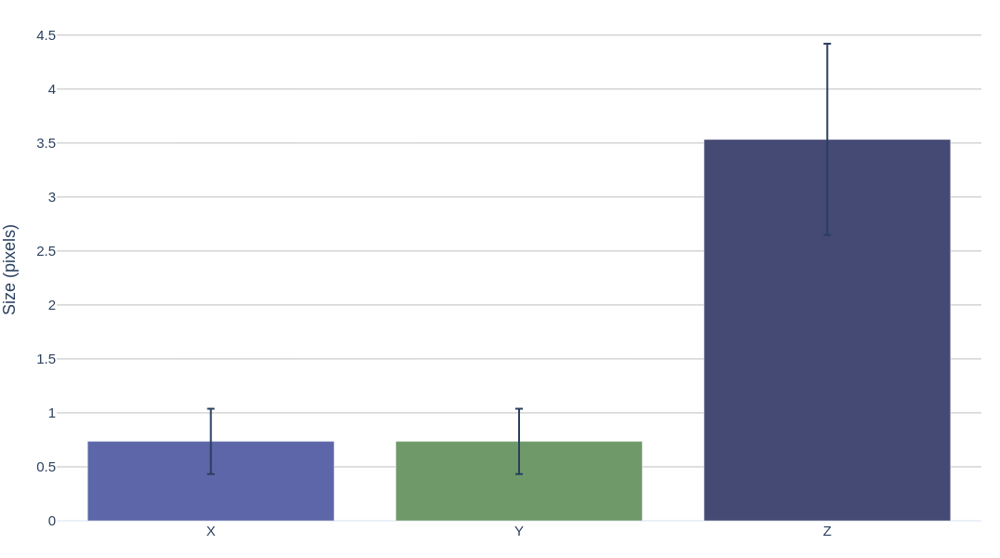

In [472]:
import random
x_ticks = ['X', 'Y', 'Z']  # Base positions for each group of bars
y_axis_title = 'Spacing (mm)'
colors_sub = np.random.choice(colors, 3, replace=False)
plot_spacing_variability_plotly(['X', 'Y', 'Z'],
                            [mean_x_axial, mean_y_axial, mean_z_axial],
                            [std_x_axial, std_y_axial, std_z_axial], 
                            colors_sub,
                            'spacing_DWI_Axial',
                            save_as_pdf=True)

### ADC

In [520]:
image_spacings_axial = []

for image in tqdm(train_ds):
    if 'axial' in image.keys():
        image_spacings_axial.append(list(image['axial_meta_dict']['pixdim'][1:4]))

  0%|          | 0/427 [00:00<?, ?it/s]

In [521]:
xs_axial = [dim[0] for dim in image_spacings_axial]
ys_axial = [dim[1] for dim in image_spacings_axial]
zs_axial = [dim[2] for dim in image_spacings_axial]

In [522]:
mean_x_axial = np.mean(xs_axial)
std_x_axial = np.std(xs_axial)
mean_y_axial = np.mean(ys_axial)
std_y_axial = np.std(ys_axial)
mean_z_axial = np.mean(zs_axial)
std_z_axial = np.std(zs_axial)

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:206: RuntimeWarning:

Degrees of freedom <= 0 for slice

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:163: RuntimeWarning:

invalid value encountered in divide

/nvmescratch/ceib/envs/monai130/lib64/python3.10/site-packages/numpy/core/_methods.py:198: RuntimeWarning:

invalid value encountered in scalar divide



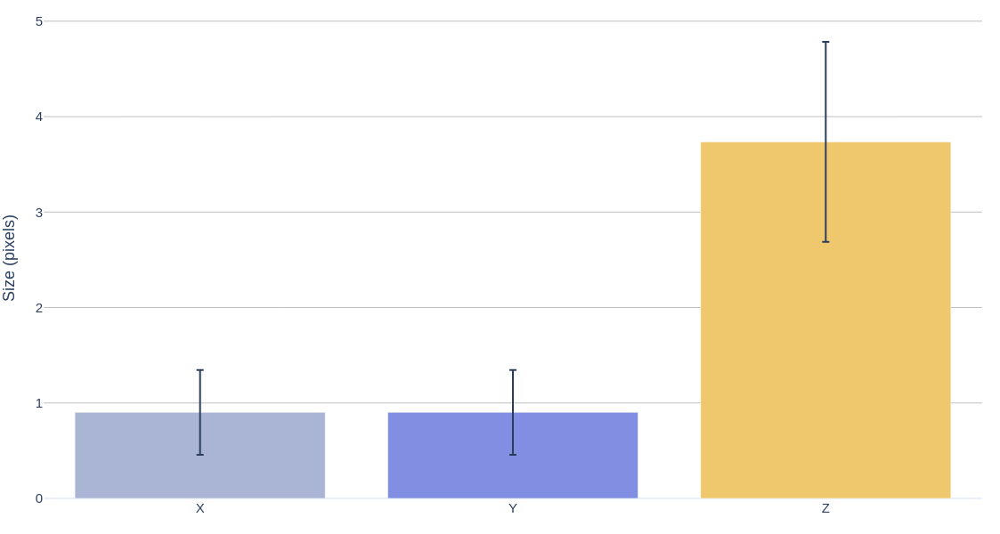

In [525]:
import random
x_ticks = ['X', 'Y', 'Z']  # Base positions for each group of bars
y_axis_title = 'Spacing (mm)'
colors_sub = np.random.choice(colors, 3, replace=False)
plot_spacing_variability_plotly(['X', 'Y', 'Z'],
                            [mean_x_axial, mean_y_axial, mean_z_axial],
                            [std_x_axial, std_y_axial, std_z_axial], 
                            colors_sub,
                            'spacing_ADC_Axial',
                            save_as_pdf=True)

## Orientation

### T2w

In [127]:
image_orientation_axial = []
image_orientation_coronal = []
image_orientation_sagital = []

for image in tqdm(train_ds):
    if 'sagital' in image.keys():
        image_orientation_sagital.append(image['sagital_meta_dict']['space'])
    if 'coronal' in image.keys():
        image_orientation_coronal.append(image['coronal_meta_dict']['space'])
    if 'axial' in image.keys():
        image_orientation_axial.append(image['axial_meta_dict']['space'])

  0%|          | 0/496 [00:00<?, ?it/s]

In [131]:
orientation_counts_axial = {str(orientation): image_orientation_axial.count(orientation) for orientation in set(image_orientation_axial)}
orientation_counts_coronal = {str(orientation): image_orientation_coronal.count(orientation) for orientation in set(image_orientation_coronal)}
orientation_counts_sagital = {str(orientation): image_orientation_sagital.count(orientation) for orientation in set(image_orientation_sagital)}

In [ ]:
plot_orientation_distribution(orientation_counts_sagital)

## Image Intensities

### T2w

In [49]:
def sample_intensities(image, sample_size=1000):
    """Sample a fixed number of pixels from an image."""
    flattened = image.flatten()
    sampled_indices = np.random.choice(len(flattened), size=sample_size, replace=False)
    return flattened[sampled_indices]

intensity_values_axial = []
intensity_values_coronal = []
intensity_values_sagital = []

for image in tqdm(train_ds):
    if 'sagital' in image.keys():
        intensity_values_sagital.append(sample_intensities(image['sagital']))
    if 'coronal' in image.keys():
        intensity_values_coronal.append(sample_intensities(image['coronal']))
    if 'axial' in image.keys():
        intensity_values_axial.append(sample_intensities(image['axial']))



  0%|          | 0/496 [00:00<?, ?it/s]

100%|██████████| 496/496 [02:27<00:00,  3.35it/s]


In [54]:
#flatten the lists
intensity_values_axial = [item for sublist in intensity_values_axial for item in sublist]
intensity_values_coronal = [item for sublist in intensity_values_coronal for item in sublist]
intensity_values_sagital = [item for sublist in intensity_values_sagital for item in sublist]

In [55]:
def plot_intensity_histograms_subplots(intensity_values_axial, intensity_values_coronal, intensity_values_sagittal,colors,bins=50):
    # Create a 3x1 subplot layout
    fig = make_subplots(rows=3, cols=1, subplot_titles=('Axial Orientation', 'Coronal Orientation', 'Sagittal Orientation'))
    
    # Axial histogram
    fig.add_trace(
        go.Histogram(x=intensity_values_axial, name='Axial', marker_color=colors[0], nbinsx=bins),
        row=1, col=1
    )
    
    # Coronal histogram
    fig.add_trace(
        go.Histogram(x=intensity_values_coronal, name='Coronal', marker_color=colors[1], nbinsx=bins),
        row=2, col=1
    )
    
    # Sagittal histogram
    fig.add_trace(
        go.Histogram(x=intensity_values_sagittal, name='Sagittal', marker_color=colors[2], nbinsx=bins),
        row=3, col=1
    )
    
    # Update layout for the figure
    fig.update_layout(
        title_text='Histogram of Image Intensities by Orientation',
        title_font_size=20,
        template='plotly_white',  # Use a white background for cleaner appearance
        font=dict(size=18),
        height=900  # Adjust height to accommodate three subplots
    )
    
    # Update x-axis and y-axis labels
    fig.update_xaxes(title_text='Intensity', row=3, col=1)
    fig.update_yaxes(title_text='Frequency', col=1)

    fig.show()
def plot_intensity_boxplots_subplots(intensity_values_axial, intensity_values_coronal, intensity_values_sagittal,colors):
    # Create a 1x3 subplot layout
    fig = make_subplots(rows=1, cols=3, subplot_titles=('Axial', 'Coronal', 'Sagittal'))
    
    # Axial boxplot
    fig.add_trace(
        go.Box(y=intensity_values_axial, name='Axial', marker_color=colors[0], boxmean='sd'), # boxmean='sd' shows the mean and standard deviation
        row=1, col=1
    )
    
    # Coronal boxplot
    fig.add_trace(
        go.Box(y=intensity_values_coronal, name='Coronal', marker_color=colors[1], boxmean='sd'),
        row=1, col=2
    )
    
    # Sagittal boxplot
    fig.add_trace(
        go.Box(y=intensity_values_sagittal, name='Sagittal', marker_color=colors[2], boxmean='sd'),
        row=1, col=3
    )
    
    # Update layout for the figure
    fig.update_layout(
        title_text='Boxplot of Image Intensities by Orientation',
        title_font_size=20,
        template='plotly_white',  # Use a white background for cleaner appearance
        font=dict(size=18),
        height=600,  # Adjust height as needed
        width=1000  # Adjust width to accommodate three subplots
    )
    
    fig.show()

In [62]:
np.min(intensity_values_axial), np.max(intensity_values_axial)

(0.0, 5116.0)

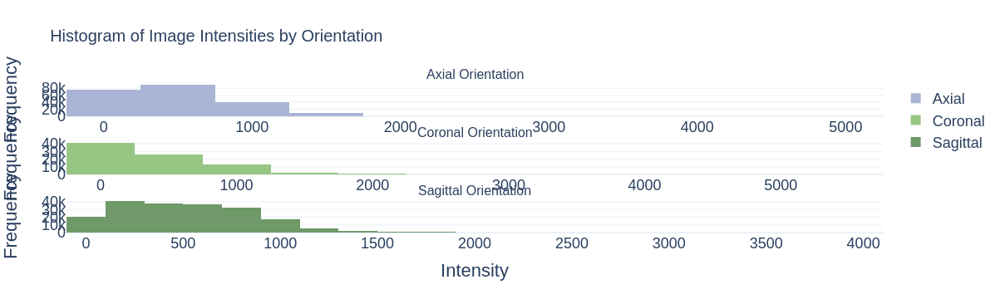

In [63]:
colors_sub = np.random.choice(colors, 3, replace=False)
plot_intensity_histograms_subplots(intensity_values_axial, intensity_values_coronal, intensity_values_sagital,colors_sub,bins=25)

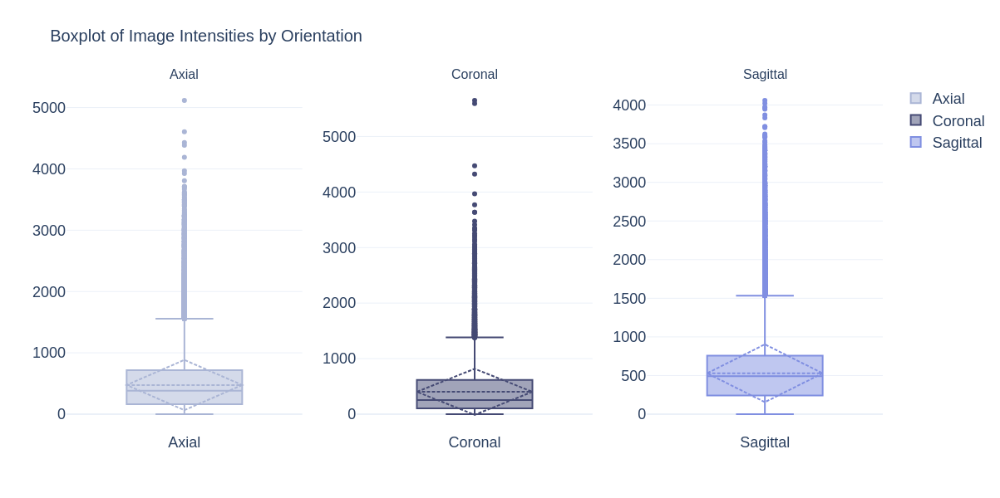

In [58]:
plot_intensity_boxplots_subplots(intensity_values_axial, intensity_values_coronal, intensity_values_sagital,colors_sub)

In [98]:
import numpy as np
from tqdm import tqdm

def compute_histogram(image, bin_max_value, bins=30):
    """Compute the histogram of an image."""
    bins_values = np.linspace(0, bin_max_value, bins)
    histogram, bins_values = np.histogram(image.flatten(), bins=bins_values)

    return histogram, bins_values

def average_histograms(histograms):
    """Average a list of histograms."""
    return np.mean(histograms, axis=0)

# Initialize lists to hold histograms for each orientation
histograms_axial = []
bins_axial = []

histograms_coronal = []
bins_coronal = []

histograms_sagital = []
bins_sagital = []

# Loop through your dataset
for image in tqdm(train_ds):
    
    if 'sagital' in image.keys():
        histogram , bins = compute_histogram(image['sagital'],bin_max_value=3500)
        histograms_sagital.append(histogram)
        bins_sagital.append(bins)
    if 'coronal' in image.keys():
        histogram , bins = compute_histogram(image['coronal'],bin_max_value=5000)
        histograms_coronal.append(histogram)
        bins_coronal.append(bins)
    if 'axial' in image.keys():
        histogram , bins = compute_histogram(image['axial'], bin_max_value=4000)
        histograms_axial.append(histogram)
        bins_axial.append(bins)

# Average the histograms for each orientation
avg_histogram_axial = average_histograms(histograms_axial)
avg_histogram_coronal = average_histograms(histograms_coronal)
avg_histogram_sagital = average_histograms(histograms_sagital)




100%|██████████| 496/496 [01:25<00:00,  5.83it/s]


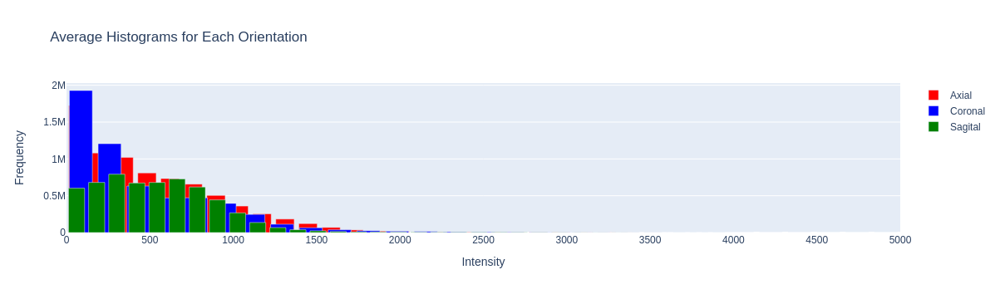

In [99]:
def plot_histograms(avg_histogram_axial, bins_axial, 
                    avg_histogram_coronal, bins_coronal, 
                    avg_histogram_sagital, bins_sagital):
    # Calculate the center of the bins
    x_axial = (bins_axial[:-1] + bins_axial[1:]) / 2
    x_coronal = (bins_coronal[:-1] + bins_coronal[1:]) / 2
    x_sagital = (bins_sagital[:-1] + bins_sagital[1:]) / 2
    
    # Create traces
    trace_axial = go.Bar(x=x_axial, y=avg_histogram_axial, name='Axial', marker_color='red')
    trace_coronal = go.Bar(x=x_coronal, y=avg_histogram_coronal, name='Coronal', marker_color='blue')
    trace_sagital = go.Bar(x=x_sagital, y=avg_histogram_sagital, name='Sagital', marker_color='green')
    
    # Create layout
    layout = go.Layout(
        title='Average Histograms for Each Orientation',
        xaxis_title='Intensity',
        yaxis_title='Frequency',
        barmode='overlay', # Use 'overlay' to plot bars on top of each other
        #smith=0.6 # Adjust opacity to make the overlay visible
    )
    
    # Create figure and add traces
    fig = go.Figure(data=[trace_axial, trace_coronal, trace_sagital], layout=layout)
    
    # Show figure
    fig.show()

# Example call to the plotting function
# Note: You would replace `bins_axial[0]`, `bins_coronal[0]`, `bins_sagital[0]`
# with the actual bin edges arrays you obtained from your histogram calculations.
plot_histograms(avg_histogram_axial, bins_axial[0], 
                avg_histogram_coronal, bins_coronal[0], 
                avg_histogram_sagital, bins_sagital[0])


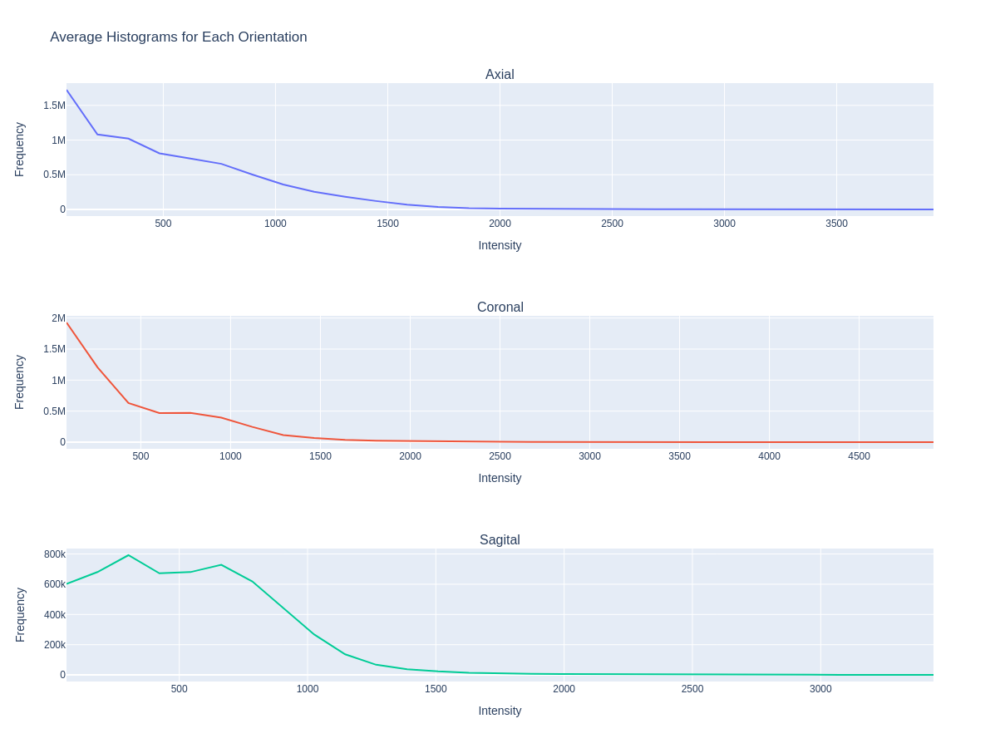

In [100]:
def plot_histograms_lines_subplots(avg_histogram_axial, bins_axial, 
                                   avg_histogram_coronal, bins_coronal, 
                                   avg_histogram_sagital, bins_sagital):
    # Calculate the center of the bins for more accurate line placement
    x_axial = (bins_axial[:-1] + bins_axial[1:]) / 2
    x_coronal = (bins_coronal[:-1] + bins_coronal[1:]) / 2
    x_sagital = (bins_sagital[:-1] + bins_sagital[1:]) / 2
    
    # Create a subplot for each orientation
    fig = make_subplots(rows=3, cols=1, subplot_titles=("Axial", "Coronal", "Sagital"))

    # Add line plot for each orientation
    fig.add_trace(go.Scatter(x=x_axial, y=avg_histogram_axial, mode='lines', name='Axial'), row=1, col=1)
    fig.add_trace(go.Scatter(x=x_coronal, y=avg_histogram_coronal, mode='lines', name='Coronal'), row=2, col=1)
    fig.add_trace(go.Scatter(x=x_sagital, y=avg_histogram_sagital, mode='lines', name='Sagital'), row=3, col=1)
    
    # Update layout to fine-tune the visualization
    fig.update_layout(height=900, width=600, 
                      title_text="Average Histograms for Each Orientation",
                      showlegend=False)
    
    # Update xaxis and yaxis titles for each subplot
    fig.update_xaxes(title_text="Intensity", row=1, col=1)
    fig.update_xaxes(title_text="Intensity", row=2, col=1)
    fig.update_xaxes(title_text="Intensity", row=3, col=1)
    fig.update_yaxes(title_text="Frequency", row=1, col=1)
    fig.update_yaxes(title_text="Frequency", row=2, col=1)
    fig.update_yaxes(title_text="Frequency", row=3, col=1)

    # Show figure
    fig.show()

# Example call to the plotting function with dummy data
# You should replace the bin edge arrays (e.g., bins_axial[0]) with your actual bin edges arrays obtained from your histogram calculations.
plot_histograms_lines_subplots(avg_histogram_axial, bins_axial[0], 
                               avg_histogram_coronal, bins_coronal[0], 
                               avg_histogram_sagital, bins_sagital[0])

# Clinical Variables

In [3]:
clinical = pd.read_csv("/home/jaalzate/Prostate_Cancer_TFM/Files/Own_data/Clinical_Variables.tsv", sep="\t")
grouped_clinical =  clinical.groupby("project")

## Training

In [4]:
training = grouped_clinical.get_group("p0052021")
training.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10117 entries, 192 to 10308
Data columns (total 19 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   project         10117 non-null  object 
 1   dep             10114 non-null  float64
 2   CRC             10116 non-null  float64
 3   label_subject   10117 non-null  int64  
 4   label_session   10117 non-null  int64  
 5   ED              10117 non-null  float64
 6   AF              72 non-null     float64
 7   TB              3321 non-null   float64
 8   TR              43 non-null     float64
 9   PSA             6431 non-null   float64
 10  VP              5177 non-null   float64
 11  PIR             2858 non-null   float64
 12  csPC            8628 non-null   float64
 13  F_nacimiento    10117 non-null  object 
 14  F_RM            10117 non-null  object 
 15  F_TACTO_RECTAL  43 non-null     object 
 16  F_PSA           6431 non-null   object 
 17  F_csPC          8628 non-null   ob

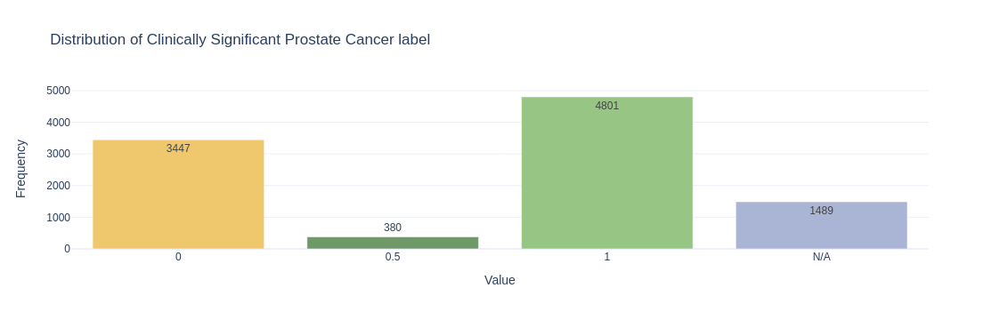

In [84]:
csPC_counts = training["csPC"].value_counts(dropna=False).to_dict()
csPC_counts = {key: csPC_counts[key] for key in sorted(csPC_counts)}
label, count = [i for i in range(len(csPC_counts.keys()))], list(csPC_counts.values())
plot_bar_simple(label, count, 
                title="Distribution of Clinically Significant Prostate Cancer label",
                x_axis = "Value", 
                variable_names = list(csPC_counts.keys()),
                size=(800, 400),
                out_filename="distribution_csPC")

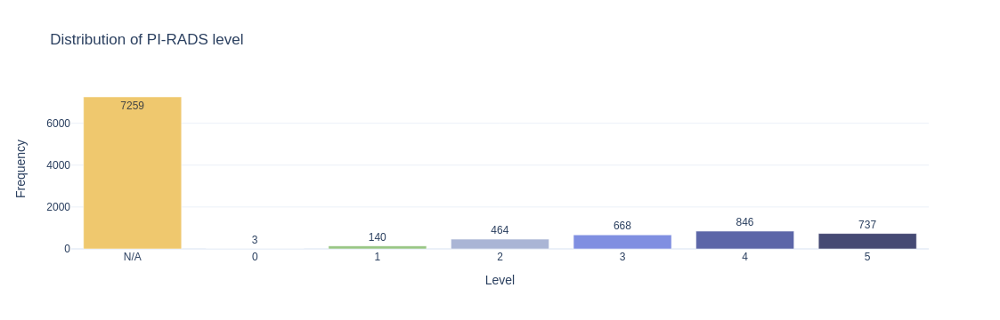

In [85]:
pir_counts = training["PIR"].value_counts(dropna=False).to_dict()
pir_counts = {key: pir_counts[key] for key in sorted(pir_counts)}
label, count = [i for i in range(len(pir_counts.keys()))], list(pir_counts.values())
plot_bar_simple(label, count, 
                title="Distribution of PI-RADS level",
                x_axis = "Level", 
                variable_names = list(pir_counts.keys()),
                size=(800, 400),
                out_filename="distribution_pirads")

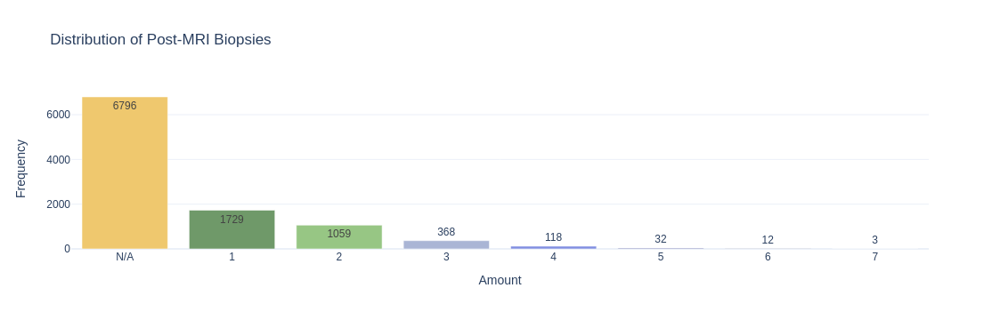

In [86]:
tb_counts = training["TB"].value_counts(dropna=False).to_dict()
tb_counts = {key: tb_counts[key] for key in sorted(tb_counts)}
label, count = [i for i in range(len(tb_counts.keys()))], list(tb_counts.values())
plot_bar_simple(label, count, 
                title="Distribution of Post-MRI Biopsies",
                x_axis = "Amount", 
                variable_names = list(tb_counts.keys()),
                size=(800, 400),
                out_filename="distribution_tb")

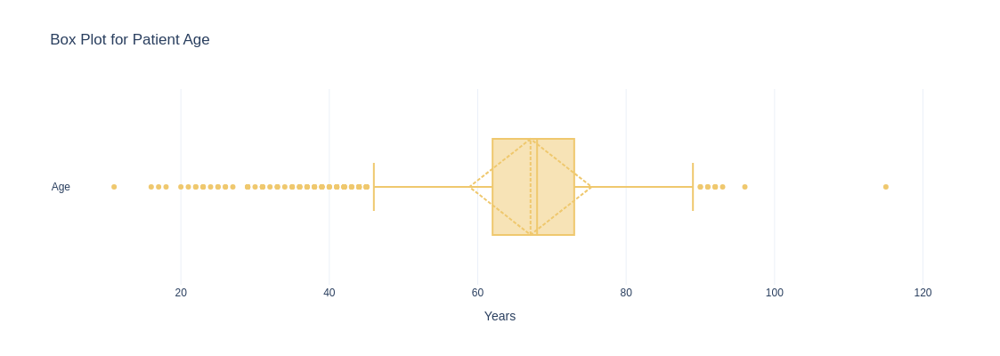

In [87]:
plot_box_simple("Age", training["ED"], 
                title="Box Plot for Patient Age", 
                x_axis = "Years",
                size=(800, 400), 
                out_filename="boxplot_age")

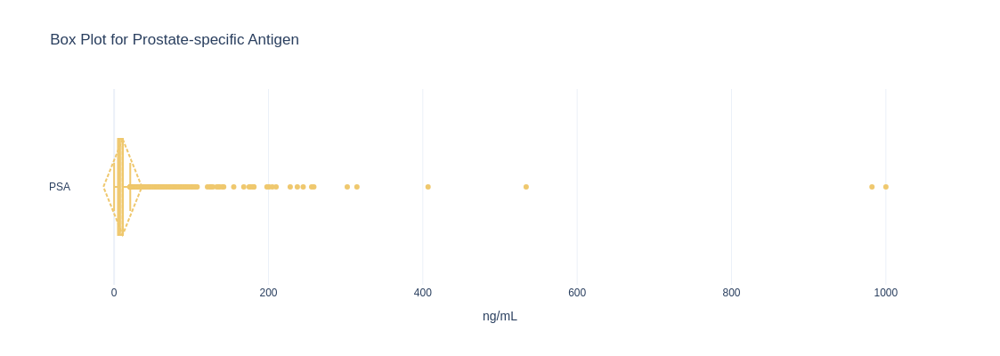

In [88]:
plot_box_simple("PSA", training["PSA"], 
                title="Box Plot for Prostate-specific Antigen",
                x_axis = "ng/mL",
                size=(800, 400), 
                out_filename="boxplot_psa")

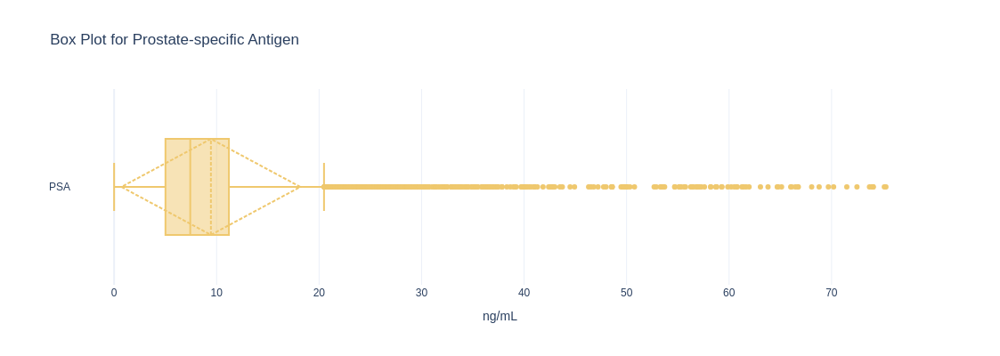

In [15]:
filtered_psa = training["PSA"].loc[training["PSA"] < training["PSA"].quantile(0.99)]
plot_box_simple("PSA", filtered_psa, 
                title="Box Plot for Prostate-specific Antigen",
                x_axis = "ng/mL",
                size=(800, 400), 
                out_filename="boxplot_filtered_psa")

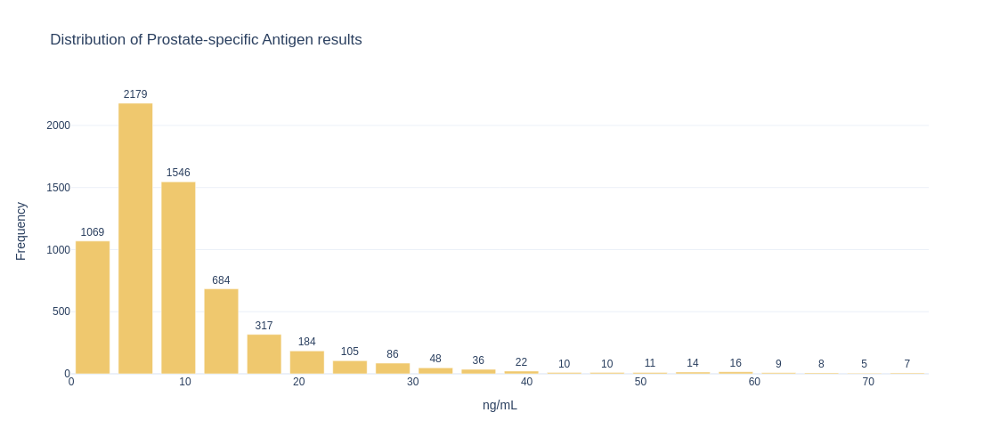

In [16]:
hist, bin_edges = np.histogram(filtered_psa, bins=20)

bins = 0.5 * (bin_edges[:-1] + bin_edges[1:])

# Create traces
trace = go.Bar(x=bins, y=hist, text=hist, textposition="outside", marker_color=colors[0])

# Create layout
layout = go.Layout(
    title='Distribution of Prostate-specific Antigen results',
    xaxis_title='ng/mL',
    yaxis_title='Frequency'
)

# Create figure and add traces
fig = go.Figure(data=trace, layout=layout)

fig.update_layout(
    template='plotly_white',
    height=500
)

# Show figure
fig.show()

fig.write_image(os.path.join(figures_dir,"barplot_filtered_psa."+extension))

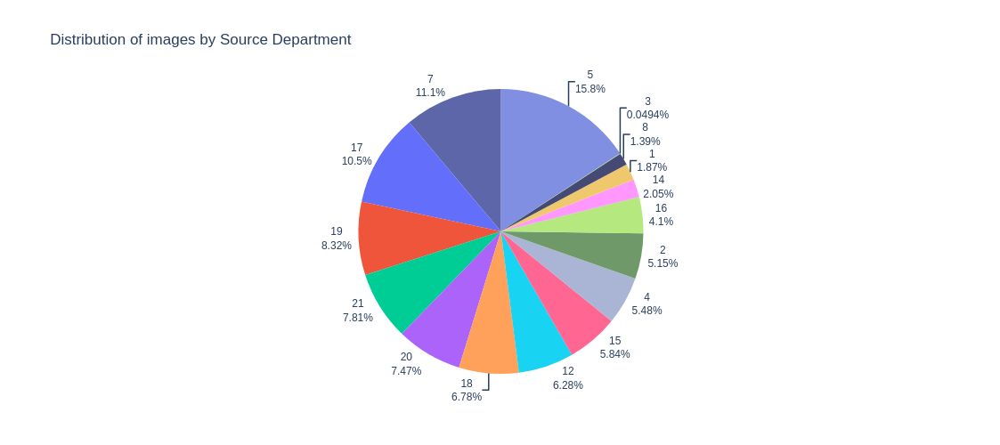

In [91]:
dep_counts = training["dep"].value_counts(normalize=True, dropna=True).to_dict()
dep_counts = {key: dep_counts[key] for key in sorted(dep_counts)}
label, count = list(dep_counts.keys()), list(dep_counts.values())
plot_pie_simple(label, count, 
                title="Distribution of images by Source Department", 
                size=(500, 500),
                out_filename="images_by_sourcedepartment")

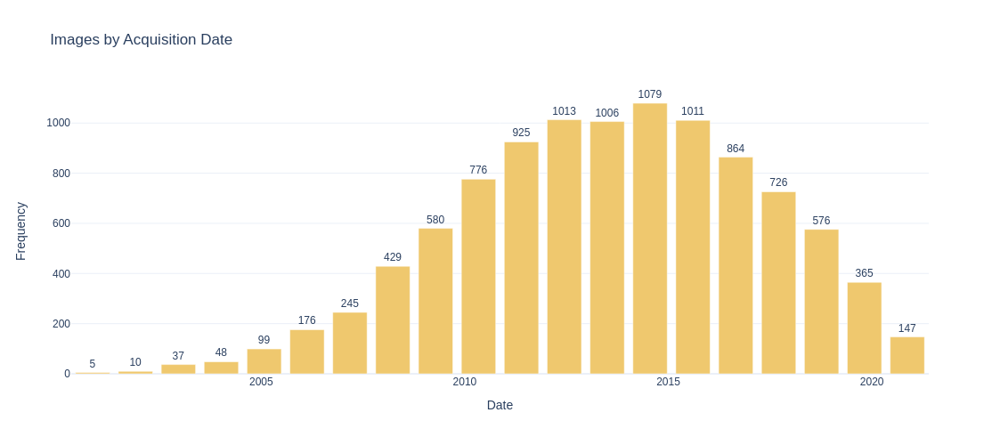

In [17]:
import numpy as np
import plotly.express as px
from datetime import datetime, date

dates = list(training["F_RM"].map(lambda x: datetime.strptime(x,"%Y-%m-%d").date()).values)

to_timestamp = np.vectorize(lambda x: (x - date(1970, 1, 1)).total_seconds())
from_timestamp = np.vectorize(lambda x: datetime.utcfromtimestamp(x))

## Compute the histogram
hist, bin_edges = np.histogram(to_timestamp(dates), bins=20)

bins = 0.5 * (bin_edges[:-1] + bin_edges[1:])

# Create traces
trace = go.Bar(x=from_timestamp(bins), y=hist, text=hist, textposition="outside", marker_color=colors[0])

# Create layout
layout = go.Layout(
    title='Images by Acquisition Date',
    xaxis_title='Date',
    yaxis_title='Frequency'
)

# Create figure and add traces
fig = go.Figure(data=trace, layout=layout)

fig.update_layout(
    template='plotly_white',
    height=500
)

# Show figure
fig.show()

fig.write_image(os.path.join(figures_dir,"images_by_acq_date."+extension))

---
**PENDING**

training["VP_segmentation"] = training.apply(lambda x: get_seg_prostate_volume(x.label_subject, x.label_session), axis=1)
plot_box_simple("PV", training["VP_segmentation"], 
                title="Box Plot for Prostate Volume (computed from automatic segmentation)",
                x_axis = f"cm\N{SUPERSCRIPT THREE}",
                size=(800, 400), 
                out_filename="boxplot_vp_segmentation")
                
---

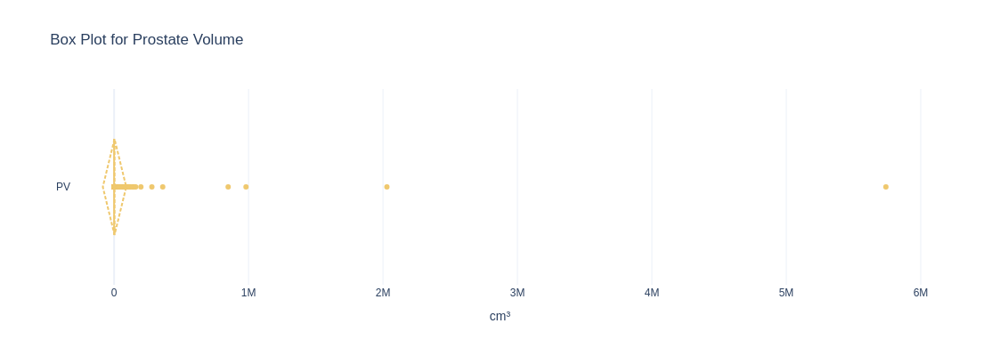

In [93]:
plot_box_simple("PV", training["VP"], 
                title="Box Plot for Prostate Volume",
                x_axis = f"cm\N{SUPERSCRIPT THREE}",
                size=(800, 400), 
                out_filename="boxplot_vp")

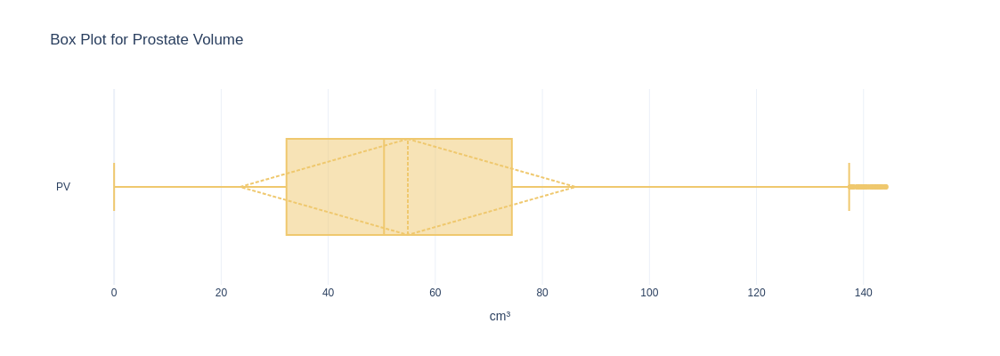

In [94]:
filtered_vp = training["VP"].loc[training["VP"] < training["VP"].quantile(0.9)]
plot_box_simple("PV", filtered_vp, 
                title="Box Plot for Prostate Volume",
                x_axis = f"cm\N{SUPERSCRIPT THREE}",
                size=(800, 400), 
                out_filename="boxplot_filtered_vp")